https://en.wikipedia.org/wiki/List_of_Bollywood_films_of_1920

In [1]:
import requests
import pandas as pd
from tqdm import tqdm
import re

import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML

In [2]:
# url = "https://en.wikipedia.org/wiki/List_of_Bollywood_films_of_2020"
# website_url = requests.get(url).text

In [3]:
from bs4 import BeautifulSoup
# soup = BeautifulSoup(website_url, "lxml")
# print(soup.prettify())

In [4]:
df = pd.DataFrame()
yr_range = range(1920,2022)
# url_fstr = f"https://en.wikipedia.org/wiki/List_of_Bollywood_films_of_{}"

In [16]:
for yr in tqdm(yr_range):
    url = f"https://en.wikipedia.org/wiki/List_of_Bollywood_films_of_{yr}"
    website_url = requests.get(url).text
    soup = BeautifulSoup(website_url, "lxml")
    film_tables = soup.findAll("table", {"class":"wikitable"})
    film_table_dfs = pd.read_html(url, attrs={"class": "wikitable"}, header=0)
    if len(film_tables)!=len(film_table_dfs):
        film_table_dfs += pd.read_html(url, attrs={"class": "wikitable sortable"}, header=0)
    assert len(film_tables)==len(film_table_dfs), f"{len(film_tables)}, {len(film_table_dfs)}"
    for i in range(len(film_tables)):
        if film_table_dfs[i].columns is None or 'Title' not in film_table_dfs[i].columns.tolist():
            continue
        for titles in film_table_dfs[i]['Title']:
            links = film_tables[i].findAll('a', text=titles)
            for link in links:
                film_url = "https://en.wikipedia.org" + link.get('href')
                if 'redlink=1' in film_url:
                    continue
                try:
#                     song_table_list = pd.read_html(film_url, attrs={"class": "tracklist"})
                    song_table_list = pd.read_html(film_url)
                except:
                    print(f"no soundtracks found for {film_url} , skipping!")
                    continue
                for song_table in song_table_list:
                    try:
                        df_curr_to_copy = song_table[song_table.columns & ['Title', 'Singer(s)', 'Lyricist', 'Singer', 'Music',
                                                                          'Lyrics', 'Composer', 'Artist', 'Artist(s)']]
                        df_curr_to_copy['year'] = yr
                        df = pd.concat([df, df_curr_to_copy])
                    except:
                        print(f"Columns not found, available columns are --> {song_table.columns.tolist()}")
                        print(f"Relevant URL --> {film_url}")
                        continue



  0%|          | 0/81 [00:00<?, ?it/s]/Users/ashish.jha/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


  1%|          | 1/81 [01:07<1:30:17, 67.72s/it]

  2%|▏         | 2/81 [02:58<1:46:19, 80.75s/it]

  4%|▎         | 3/81 [04:18<1:44:23, 80.31s/it]

no soundtracks found for https://en.wikipedia.org/wiki/Bhagya_Laxmi , skipping!




  5%|▍         | 4/81 [07:03<2:15:46, 105.80s/it]

  6%|▌         | 5/81 [07:19<1:39:44, 78.74s/it] 

Columns not found, available columns are --> [('Anmol Ghadi', 'Soundtrack album by Naushad'), ('Anmol Ghadi', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Anmol_Ghadi
Columns not found, available columns are --> [('Room No. 9 OST', 'Soundtrack album by Various artists'), ('Room No. 9 OST', 'Soundtrack album by Various artists.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Room_No._9
Columns not found, available columns are --> [('Ep.', 'Ep.'), ('Original broadcast date', 'Original broadcast date'), ('Average audience share(AGB Nielsen)[11]', 'Nationwide'), ('Average audience share(AGB Nielsen)[11]', 'Seoul')]
Relevant URL --> https://en.wikipedia.org/wiki/Room_No._9




  7%|▋         | 6/81 [09:37<2:00:44, 96.60s/it]

  9%|▊         | 7/81 [10:03<1:33:12, 75.57s/it]

 10%|▉         | 8/81 [10:23<1:11:31, 58.78s/it]

Columns not found, available columns are --> [('Ziddi', 'Soundtrack album by Khemchand Prakash'), ('Ziddi', 'Soundtrack album by Khemchand Prakash.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ziddi_(1948_film)
Columns not found, available columns are --> [('Barsaat', 'Studio album by Shankar Jaikishan'), ('Barsaat', 'Studio album by Shankar Jaikishan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Barsaat_(1949_film)
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Barsaat_(1949_film)
Columns not found, available columns are --> [('Andaz', 'Soundtrack album by Naushad'), ('Andaz', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Andaz_(1949_film)
Columns not found, available columns are --> [('Bari Behen', 'Studio album by Husnlal Bhagatram'), ('Bari Be



 11%|█         | 9/81 [10:57<1:01:45, 51.46s/it]

Columns not found, available columns are --> [('Babul', 'Soundtrack album by Naushad'), ('Babul', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Babul_(1950_film)
Columns not found, available columns are --> [('Babul', 'Soundtrack album by Naushad'), ('Babul', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Babul_(1950_film)
Columns not found, available columns are --> [('Magroor', 'Soundtrack album by Sajjad Hussain'), ('Magroor', 'Soundtrack album by Sajjad Hussain.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Magroor_(1950_film)
Columns not found, available columns are --> [('Magroor', 'Soundtrack album by Bulo C. Rani'), ('Magroor', 'Soundtrack album by Bulo C. Rani.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Magroor_(195



 12%|█▏        | 10/81 [11:27<53:01, 44.82s/it] 

Columns not found, available columns are --> [('Baazi', 'Studio album by Sachin Dev Burman'), ('Baazi', 'Studio album by Sachin Dev Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Baazi_(1951_film)
Columns not found, available columns are --> [('Bahar', 'Soundtrack album by S. D. Burman'), ('Bahar', 'Soundtrack album by S. D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bahar_(film)
Columns not found, available columns are --> [('Baazi', 'Studio album by Sachin Dev Burman'), ('Baazi', 'Studio album by Sachin Dev Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Baazi_(1951_film)
Columns not found, available columns are --> [('Bahar', 'Soundtrack album by S. D. Burman'), ('Bahar', 'Soundtrack album by S. D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bahar_(film)
Columns not found, available columns are --> [('Review scores', 'Publication'), ('Revi



 14%|█▎        | 11/81 [12:03<49:21, 42.31s/it]

Columns not found, available columns are --> [('Aan', 'Soundtrack album by Naushad'), ('Aan', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aan
Columns not found, available columns are --> [('Baiju Bawra', 'Soundtrack album by Naushad'), ('Baiju Bawra', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Baiju_Bawra_(film)
Columns not found, available columns are --> [('Aan', 'Soundtrack album by Naushad'), ('Aan', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aan_(1952_film)
Columns not found, available columns are --> [('Baiju Bawra', 'Soundtrack album by Naushad'), ('Baiju Bawra', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Baiju_Bawra_(1952_film)
Columns not found, av



 15%|█▍        | 12/81 [12:32<44:11, 38.43s/it]

Columns not found, available columns are --> [('Naulakha Haar', 'Soundtrack album by Bhola Srestha'), ('Naulakha Haar', 'Soundtrack album by Bhola Srestha.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Naulakha_Haar




 16%|█▌        | 13/81 [13:07<42:05, 37.13s/it]

Columns not found, available columns are --> [('Amar', 'Soundtrack album by Naushad'), ('Amar', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Amar_(1954_film)
Columns not found, available columns are --> [('Amar', 'Soundtrack album by Naushad'), ('Amar', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Amar_(1954_film)
Columns not found, available columns are --> [('Shabaab', 'Soundtrack album by Naushad'), ('Shabaab', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Shabaab_(film)




 17%|█▋        | 14/81 [13:54<44:48, 40.12s/it]

Columns not found, available columns are --> [('Uran Khatola', 'Soundtrack album by Naushad'), ('Uran Khatola', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Uran_Khatola_(film)
Columns not found, available columns are --> [('Munimji', 'Soundtrack album by S.D. Burman'), ('Munimji', 'Soundtrack album by S.D. Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Munimji
Columns not found, available columns are --> [('Baap Re Baap (Original Motion Picture Soundtrack)', 'Soundtrack album by O. P. Nayyar'), ('Baap Re Baap (Original Motion Picture Soundtrack)', 'Soundtrack album by O. P. Nayyar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Baap_Re_Baap
Columns not found, available columns are --> [('Milap', 'Soundtrack album by Datta Naik'), ('Milap', 'Soundtrack album by Datta Naik.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Milap_(1955_film)
Columns not found, available columns are --> [('M



 19%|█▊        | 15/81 [14:36<44:45, 40.68s/it]

Columns not found, available columns are --> [('C.I.D. (Original Motion Picture Soundtrack)', 'Soundtrack album by O. P. Nayyar'), ('C.I.D. (Original Motion Picture Soundtrack)', 'Soundtrack album by O. P. Nayyar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/C.I.D._(1956_film)
Columns not found, available columns are --> [('Funtoosh', 'Soundtrack album by S.D. Burman & R.D. Burman'), ('Funtoosh', 'Soundtrack album by S.D. Burman & R.D. Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Funtoosh
Columns not found, available columns are --> [('C.I.D. (Original Motion Picture Soundtrack)', 'Soundtrack album by O. P. Nayyar'), ('C.I.D. (Original Motion Picture Soundtrack)', 'Soundtrack album by O. P. Nayyar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/C.I.D._(1956_film)
Columns not found, available columns are --> [('Funtoosh', 'Soundtrack album by S.D. Burman & R.D. Burman'), ('Funtoosh', 'Soundtrack album by S.D. Burman & R.D. Burman.1')]
Relevant URL --> https://en.



 20%|█▉        | 16/81 [15:22<46:01, 42.49s/it]

Columns not found, available columns are --> [('Mother India', 'Soundtrack album by Naushad'), ('Mother India', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Mother_India
Columns not found, available columns are --> [('Tumsa Nahin Dekha', 'Soundtrack album by O. P. Nayyar'), ('Tumsa Nahin Dekha', 'Soundtrack album by O. P. Nayyar.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Tumsa_Nahin_Dekha_(1957_film)
Columns not found, available columns are --> [('Dushman (1957 film)', 'Soundtrack album by Husnlal Bhagatram'), ('Dushman (1957 film)', 'Soundtrack album by Husnlal Bhagatram.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dushman_(1957_film)
Columns not found, available columns are --> [('Year', "1950's"), ('Title', "1950's"), ('Role', "1950's"), ('Notes', "1950's")]
Relevant URL --> https://en.wikipedia.org/wiki/Johnny_Walker_(actor)
Columns not fou



 21%|██        | 17/81 [16:17<49:18, 46.23s/it]

Columns not found, available columns are --> [('Madhumati', 'Soundtrack album by Salil Chowdhury'), ('Madhumati', 'Soundtrack album by Salil Chowdhury.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Madhumati
Columns not found, available columns are --> [('Chalti Ka Naam Gaadi', 'Soundtrack album by S.D. Burman'), ('Chalti Ka Naam Gaadi', 'Soundtrack album by S.D. Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chalti_Ka_Naam_Gaadi
Columns not found, available columns are --> [('Sadhna', 'Soundtrack album by Datta Naik'), ('Sadhna', 'Soundtrack album by Datta Naik.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Sadhna_(1958_film)
Columns not found, available columns are --> [('Chalti Ka Naam Gaadi', 'Soundtrack album by S.D. Burman'), ('Chalti Ka Naam Gaadi', 'Soundtrack album by S.D. Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chalti_Ka_Naam_Gaadi
Columns not found, available columns are --> [('Madhumati',



 22%|██▏       | 18/81 [17:25<55:14, 52.61s/it]

Columns not found, available columns are --> [('Goonj Uthi Shehnai', 'Soundtrack album by Vasant Desai'), ('Goonj Uthi Shehnai', 'Soundtrack album by Vasant Desai.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Goonj_Uthi_Shehnai
Columns not found, available columns are --> [('Chhoti Bahen', 'Soundtrack album by Shankar-Jaikishan'), ('Chhoti Bahen', 'Soundtrack album by Shankar-Jaikishan.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chhoti_Bahen
Columns not found, available columns are --> [('Veerapandiya Kattabomman', 'Soundtrack album by G. Ramanathan'), ('Veerapandiya Kattabomman', 'Soundtrack album by G. Ramanathan.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Amar_Shaheed
Columns not found, available columns are --> [('Chhoti Bahen', 'Soundtrack album by Shankar-Jaikishan'), ('Chhoti Bahen', 'Soundtrack album by Shankar-Jaikishan.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chhoti_Bahen
Columns not found, availab



 23%|██▎       | 19/81 [18:17<54:05, 52.35s/it]

Columns not found, available columns are --> [('Mughal-e-Azam', 'Soundtrack album by Naushad'), ('Mughal-e-Azam', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Mughal-e-Azam
Columns not found, available columns are --> [('Kohinoor', 'Soundtrack album by Naushad'), ('Kohinoor', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kohinoor_(1960_film)
Columns not found, available columns are --> [('Chhalia', 'Soundtrack album by Kalyanji-Anandji'), ('Chhalia', 'Soundtrack album by Kalyanji-Anandji.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chhalia
Columns not found, available columns are --> [('Ek Ke Baad Ek', 'Soundtrack album by S. D. Burman'), ('Ek Ke Baad Ek', 'Soundtrack album by S. D. Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ek_Ke_Baad_Ek
Columns not found, 



 25%|██▍       | 20/81 [19:04<51:36, 50.76s/it]

Columns not found, available columns are --> [('Ganga Jamna', 'Soundtrack album by Naushad'), ('Ganga Jamna', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Gunga_Jumna
Columns not found, available columns are --> [('Zindagi Aur Khwab', 'Soundtrack album by Dattaram Wadkar'), ('Zindagi Aur Khwab', 'Soundtrack album by Dattaram Wadkar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Zindagi_aur_Khwab
Columns not found, available columns are --> [('Ganga Jamna', 'Soundtrack album by Naushad'), ('Ganga Jamna', 'Soundtrack album by Naushad.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Gunga_Jumna
Columns not found, available columns are --> [('Nazrana', 'Soundtrack album by Ravi'), ('Nazrana', 'Soundtrack album by Ravi.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Nazrana_(1961_film)




 26%|██▌       | 21/81 [19:40<46:20, 46.35s/it]

Columns not found, available columns are --> [('Zindagi Aur Khwab', 'Soundtrack album by Dattaram Wadkar'), ('Zindagi Aur Khwab', 'Soundtrack album by Dattaram Wadkar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Zindagi_aur_Khwab
Columns not found, available columns are --> [('Hariyali Aur Rasta', 'Soundtrack album by Shankar Jaikishan'), ('Hariyali Aur Rasta', 'Soundtrack album by Shankar Jaikishan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Hariyali_Aur_Raasta
Columns not found, available columns are --> [('Aarti', 'Studio album by Roshan'), ('Aarti', 'Studio album by Roshan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aarti_(film)
Columns not found, available columns are --> [('Aarti', 'Studio album by Roshan'), ('Aarti', 'Studio album by Roshan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aarti_(film)
Columns not foun



 27%|██▋       | 22/81 [20:28<46:05, 46.88s/it]

Columns not found, available columns are --> [('Shikari', 'Soundtrack album by G S Kohli'), ('Shikari', 'Soundtrack album by G S Kohli.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Shikari_(1963_film)
Columns not found, available columns are --> [('Bandini', 'Soundtrack album by S.D. Burman'), ('Bandini', 'Soundtrack album by S.D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bandini_(film)
Columns not found, available columns are --> [('Year', 'Year'), ('Title', 'Title'), ('Language', 'Language'), ('Director', 'Director'), ('Cast', 'Step-mother'), ('Cast', 'Son'), ('Cast', 'Wife')]
Relevant URL --> https://en.wikipedia.org/wiki/Bahurani_(1963_film)
Columns not found, available columns are --> [('Bandini', 'Soundtrack album by S.D. Burman'), ('Bandini', 'Soundtrack album by S.D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bandini_(1963_film)
Columns not found, a



 28%|██▊       | 23/81 [21:21<47:13, 48.86s/it]

Columns not found, available columns are --> [('Kashmir Ki Kali', 'Soundtrack album by O.P. Nayyar'), ('Kashmir Ki Kali', 'Soundtrack album by O.P. Nayyar.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kashmir_Ki_Kali
Columns not found, available columns are --> [('Woh Kaun Thi?', 'Soundtrack album by Madan Mohan'), ('Woh Kaun Thi?', 'Soundtrack album by Madan Mohan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Woh_Kaun_Thi
Columns not found, available columns are --> [('Benazir', 'Soundtrack album by Sachin Dev Burman'), ('Benazir', 'Soundtrack album by Sachin Dev Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Benazir_(1964_film)
Columns not found, available columns are --> [('Jahan Ara', 'Studio album by Madan Mohan'), ('Jahan Ara', 'Studio album by Madan Mohan.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Jahan_Ara_(fi



 30%|██▉       | 24/81 [22:07<45:26, 47.84s/it]

Columns not found, available columns are --> [('Bheegi Raat', 'Soundtrack album by Roshan'), ('Bheegi Raat', 'Soundtrack album by Roshan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bheegi_Raat
Columns not found, available columns are --> [('Guide', 'Soundtrack album by Sachin Dev Burman'), ('Guide', 'Soundtrack album by Sachin Dev Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Guide_(1965_film)
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Gumnaam_(1965_film)
Columns not found, available columns are --> [('Mere Sanam', 'Soundtrack album by O.P. Nayyar'), ('Mere Sanam', 'Soundtrack album by O.P. Nayyar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Mere_Sanam
Columns not found, available columns are --> [('Naya Kanoon', 'Soundtrack album by Madan Mohan'), ('Naya Kanoon



 31%|███       | 25/81 [22:41<40:56, 43.87s/it]

Columns not found, available columns are --> [('Suraj', 'Soundtrack album by Shankar Jaikishan'), ('Suraj', 'Soundtrack album by Shankar Jaikishan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Suraj_(1966_film)
Columns not found, available columns are --> [('Suraj', 'Soundtrack album by Shankar Jaikishan'), ('Suraj', 'Soundtrack album by Shankar Jaikishan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Suraj_(1966_film)




 32%|███▏      | 26/81 [23:26<40:19, 44.00s/it]

Columns not found, available columns are --> [('Ram Aur Shyam', 'Soundtrack album by Naushad'), ('Ram Aur Shyam', 'Soundtrack album by Naushad.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ram_Aur_Shyam
Columns not found, available columns are --> [('Hamraaz', 'Soundtrack album'), ('Hamraaz', 'Soundtrack album.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Hamraaz
Columns not found, available columns are --> [('Shagird', 'Soundtrack album by Laxmikant-Pyarelal'), ('Shagird', 'Soundtrack album by Laxmikant-Pyarelal.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Shagird
Columns not found, available columns are --> [('Patthar Ke Sanam', 'Soundtrack album by Laxmikant–Pyarelal'), ('Patthar Ke Sanam', 'Soundtrack album by Laxmikant–Pyarelal.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Patthar_Ke_Sanam
Columns not found, available columns are --> [('Gunhegaar', 'Soundtrack album by Shyam-Surender'), ('Gunhegaar', 'Soundtrac



 33%|███▎      | 27/81 [24:27<44:25, 49.36s/it]

Columns not found, available columns are --> [('Kismat', 'Soundtrack album by O.P.Nayyar'), ('Kismat', 'Soundtrack album by O.P.Nayyar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kismat_(1968_film)




 35%|███▍      | 28/81 [25:16<43:23, 49.13s/it]

Columns not found, available columns are --> [('Do Raaste', 'Soundtrack album'), ('Do Raaste', 'Soundtrack album.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Do_Raaste
Columns not found, available columns are --> [('Prince', 'Soundtrack album by Shankar Jaikishan'), ('Prince', 'Soundtrack album by Shankar Jaikishan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Prince_(1969_film)
Columns not found, available columns are --> [('Chirag', 'Studio album by Madan Mohan'), ('Chirag', 'Studio album by Madan Mohan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chirag
Columns not found, available columns are --> [('Do Raaste', 'Soundtrack album'), ('Do Raaste', 'Soundtrack album.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Do_Raaste
Columns not found, available columns are --> [('Prince', 'Soundtrack album by Shankar Jaikishan'), ('Prince', 'Soundtrack album by Shankar Jaikishan.1



 36%|███▌      | 29/81 [26:15<45:10, 52.12s/it]

Columns not found, available columns are --> [('Safar', 'Studio album by Kalyanji Anandji'), ('Safar', 'Studio album by Kalyanji Anandji.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Safar_(1970_film)
Columns not found, available columns are --> [('Heer Raanjha', 'Soundtrack album by Madan Mohan'), ('Heer Raanjha', 'Soundtrack album by Madan Mohan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Heer_Raanjha
Columns not found, available columns are --> [('Islamic calendar', 'Months')]
Relevant URL --> https://en.wikipedia.org/wiki/Safar
Columns not found, available columns are --> [('India', 'Federal government Constitution of India Law Human rights Indian Penal Code Law enforcement')]
Relevant URL --> https://en.wikipedia.org/wiki/Umang




 37%|███▋      | 30/81 [27:39<52:20, 61.59s/it]

Columns not found, available columns are --> [('Anand', 'Soundtrack album to Anand by Salil Chowdhary'), ('Anand', 'Soundtrack album to Anand by Salil Chowdhary.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Anand_(1971_film)
Columns not found, available columns are --> [('Haré Rama Haré Krishna', 'Soundtrack album by R. D. Burman'), ('Haré Rama Haré Krishna', 'Soundtrack album by R. D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Hare_Rama_Hare_Krishna_(1971_film)
Columns not found, available columns are --> [('Kati Patang', 'Soundtrack album by R. D. Burman'), ('Kati Patang', 'Soundtrack album by R. D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kati_Patang
Columns not found, available columns are --> [('Lal Patthar', 'Studio album by Shankar Jaikishan'), ('Lal Patthar', 'Studio album by Shankar Jaikishan.1'), ('Un



 38%|███▊      | 31/81 [28:50<53:43, 64.46s/it]

Columns not found, available columns are --> [('Anuraag', 'Studio album by S.D. Burman'), ('Anuraag', 'Studio album by S.D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Anuraag_(1972_film)
Columns not found, available columns are --> [('Subah-O-Shaam', 'Soundtrack album by Laxmikant–Pyarelal'), ('Subah-O-Shaam', 'Soundtrack album by Laxmikant–Pyarelal.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Subah-o-Shyam




 40%|███▉      | 32/81 [30:28<1:00:50, 74.51s/it]

Columns not found, available columns are --> [('Daag: A Poem of Love', 'Soundtrack album by Laxmikant Pyarelal'), ('Daag: A Poem of Love', 'Soundtrack album by Laxmikant Pyarelal.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Daag:_A_Poem_of_Love
Columns not found, available columns are --> [('Naya Nasha', 'Soundtrack album by Sapan Chakraborty'), ('Naya Nasha', 'Soundtrack album by Sapan Chakraborty.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Naya_Nasha
Columns not found, available columns are --> [('Nirdosh', 'Soundtrack album by Liyaqat Ajmeri & Harry Anand'), ('Nirdosh', 'Soundtrack album by Liyaqat Ajmeri & Harry Anand.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Nirdosh
Columns not found, available columns are --> [('Yaadon Ki Baaraat', 'Soundtrack album by R. D. Burman'), ('Yaadon Ki Baaraat', 'Soundtrack album by R. D. Burman.1')]
Relevant URL --> https://en.wikipedia



 41%|████      | 33/81 [31:54<1:02:19, 77.90s/it]

Columns not found, available columns are --> [('Series', 'Series'), ('Series', 'Series.1'), ('Episodes', 'Episodes'), ('Episodes', 'Episodes.1'), ('Originally aired', 'First aired'), ('Originally aired', 'Last aired')]
Relevant URL --> https://en.wikipedia.org/wiki/Aahat
Columns not found, available columns are --> [('Hawas', 'Studio album by Usha Khanna'), ('Hawas', 'Studio album by Usha Khanna.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Hawas
Columns not found, available columns are --> [('Resham Ki Dori', 'Studio album by Shankar-Jaikishan'), ('Resham Ki Dori', 'Studio album by Shankar-Jaikishan.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Resham_Ki_Dori




 42%|████▏     | 34/81 [33:24<1:03:58, 81.67s/it]

Columns not found, available columns are --> [('Aandhi: The Original Motion Picture Soundtrack', 'Soundtrack album by Rahul Dev Burman'), ('Aandhi: The Original Motion Picture Soundtrack', 'Soundtrack album by Rahul Dev Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aandhi
Columns not found, available columns are --> [('Deewaar', 'Soundtrack album to Deewaar by R.D. Burman'), ('Deewaar', 'Soundtrack album to Deewaar by R.D. Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Deewaar
Columns not found, available columns are --> [('Dharam Karam', 'Soundtrack album by R. D. Burman'), ('Dharam Karam', 'Soundtrack album by R. D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dharam_Karam
Columns not found, available columns are --> [('Dhoti Lota Aur Chowpatty', 'Soundtrack album by Shyamji Ghanshyamji'), ('Dhoti Lota Aur Chowpatty', 'Soundtrack album by Shyamji Ghanshyamji.1')]
Relevant URL --> https://en.wikipedia



 43%|████▎     | 35/81 [34:25<57:51, 75.46s/it]  

Columns not found, available columns are --> [('Kabhi Kabhie', 'Soundtrack album by Khayyam'), ('Kabhi Kabhie', 'Soundtrack album by Khayyam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kabhie_Kabhie_(1976_film)
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Kabhie_Kabhie_(1976_film)
no soundtracks found for https://en.wikipedia.org/wiki/Kadambari , skipping!
Columns not found, available columns are --> [('Nehle Pe Dehla', 'Soundtrack album by R. D. Burman'), ('Nehle Pe Dehla', 'Soundtrack album by R. D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Nehle_Pe_Dehla




 44%|████▍     | 36/81 [35:29<53:55, 71.89s/it]

Columns not found, available columns are --> [('Amar Akbar Anthony', 'Soundtrack album by Laxmikant-Pyarelal'), ('Amar Akbar Anthony', 'Soundtrack album by Laxmikant-Pyarelal.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Amar_Akbar_Anthony
Columns not found, available columns are --> [('Anand Ashram', 'Film score by Shyamal Mitra'), ('Anand Ashram', 'Film score by Shyamal Mitra.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Anand_Ashram
Columns not found, available columns are --> [('Doosra Aadmi', 'Soundtrack album by Rajesh Roshan'), ('Doosra Aadmi', 'Soundtrack album by Rajesh Roshan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Doosra_Aadmi
Columns not found, available columns are --> [('Hum Kisise Kum Naheen', 'Soundtrack album by R.D. Burman'), ('Hum Kisise Kum Naheen', 'Soundtrack album by R.D. Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Hum_Kisise_Kum_Naheen
Columns not found, available columns are --



 46%|████▌     | 37/81 [37:06<58:14, 79.42s/it]

Columns not found, available columns are --> [('Don', 'Soundtrack album by Kalyanji Anandji'), ('Don', 'Soundtrack album by Kalyanji Anandji.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Don_(1978_film)
Columns not found, available columns are --> [('Ghar', 'Soundtrack album by R.D. Burman'), ('Ghar', 'Soundtrack album by R.D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ghar_(film)
Columns not found, available columns are --> [('26th Filmfare Awards', 'Category'), ('26th Filmfare Awards', 'Nominees'), ('26th Filmfare Awards', 'Result'), ('26th Filmfare Awards', 'Unnamed: 3_level_1'), ('26th Filmfare Awards', 'Unnamed: 4_level_1'), ('26th Filmfare Awards', 'Unnamed: 5_level_1'), ('26th Filmfare Awards', 'Unnamed: 6_level_1'), ('26th Filmfare Awards', 'Unnamed: 7_level_1'), ('26th Filmfare Awards', 'Unnamed: 8_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Muqaddar_Ka_Sikandar
Columns not found, available colum



 47%|████▋     | 38/81 [37:51<49:32, 69.12s/it]

Columns not found, available columns are --> [('Noorie', 'Soundtrack album by Khayyam'), ('Noorie', 'Soundtrack album by Khayyam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Noorie
Columns not found, available columns are --> [('Hindustani classical music', 'Concepts')]
Relevant URL --> https://en.wikipedia.org/wiki/Tarana




 48%|████▊     | 39/81 [39:01<48:39, 69.51s/it]

Columns not found, available columns are --> [('Yuvvraaj', 'Soundtrack album by A. R. Rahman'), ('Yuvvraaj', 'Soundtrack album by A. R. Rahman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Yuvraaj
Columns not found, available columns are --> [('Karz', 'Soundtrack album by Laxmikant-Pyarelal'), ('Karz', 'Soundtrack album by Laxmikant-Pyarelal.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Karz_(film)
Columns not found, available columns are --> [('Red Rose', 'Soundtrack album by R. D. Burman'), ('Red Rose', 'Soundtrack album by R. D. Burman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Red_Rose_(1980_film)
Columns not found, available columns are --> [('Sitara', 'Film score by R.D. Burman'), ('Sitara', 'Film score by R.D. Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Sitara_(1980_film)




 49%|████▉     | 40/81 [40:14<48:10, 70.51s/it]

Columns not found, available columns are --> [('Ek Aur Ek Gyarah', 'Studio album by Shankar-Ehsaan-Loy'), ('Ek Aur Ek Gyarah', 'Studio album by Shankar-Ehsaan-Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ek_Aur_Ek_Gyarah
Columns not found, available columns are --> [('Year', 'Year'), ('Title', 'Title'), ('Language', 'Language'), ('Director', 'Director'), ('Cast', 'Step-mother'), ('Cast', 'Son'), ('Cast', 'Wife')]
Relevant URL --> https://en.wikipedia.org/wiki/Jyoti_(1981_film)
Columns not found, available columns are --> [('Raaz', 'Soundtrack album by Ravindra Jain'), ('Raaz', 'Soundtrack album by Ravindra Jain.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Raaz_(1981_film)




 51%|█████     | 41/81 [41:16<45:16, 67.92s/it]

Columns not found, available columns are --> [('Kadhalar Dhinam', 'Soundtrack album by A. R. Rahman'), ('Kadhalar Dhinam', 'Soundtrack album by A. R. Rahman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dil_Hi_Dil_Mein
Columns not found, available columns are --> [('Madanolsavam', 'Soundtrack album by Salil Choudhary'), ('Madanolsavam', 'Soundtrack album by Salil Choudhary.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dil_Ka_Sathi_Dil
Columns not found, available columns are --> [('Disco Dancer', 'Soundtrack album by Bappi Lahiri'), ('Disco Dancer', 'Soundtrack album by Bappi Lahiri.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Disco_Dancer
Columns not found, available columns are --> [('Namak Halaal', 'Film score by Bappi Lahiri'), ('Namak Halaal', 'Film score by Bappi Lahiri.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Namak_Halaal
Columns not found, available columns are --> [('Namkeen', 'Studio album by R. D. Bu



 52%|█████▏    | 42/81 [42:58<50:53, 78.29s/it]

Columns not found, available columns are --> [('Bandhan Kuchchey Dhaagon Ka', 'Soundtrack album by Hemant Bhonsle'), ('Bandhan Kuchchey Dhaagon Ka', 'Soundtrack album by Hemant Bhonsle.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bandhan_Kuchchey_Dhaagon_Ka
Columns not found, available columns are --> [('Hum Se Hai Zamana', 'Soundtrack album by Ram Laxman'), ('Hum Se Hai Zamana', 'Soundtrack album by Ram Laxman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Hum_Se_Hai_Zamana
Columns not found, available columns are --> [('Kalakar', 'Soundtrack album by Kalyanji-Anandji'), ('Kalakar', 'Soundtrack album by Kalyanji-Anandji.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kalakar
Columns not found, available columns are --> [('Mazdoor', 'Soundtrack album by R.D. Burman'), ('Mazdoor', 'Soundtrack album by R.D. Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Mazdoor
Columns not found, available columns are --> [('Sadma'



 53%|█████▎    | 43/81 [44:15<49:09, 77.62s/it]

Columns not found, available columns are --> [('Thaayillamal Naan Illai', 'Soundtrack album by Shankar-Ganesh'), ('Thaayillamal Naan Illai', 'Soundtrack album by Shankar-Ganesh.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aakhri_Sangram
Columns not found, available columns are --> [('Family law', 'Family')]
Relevant URL --> https://en.wikipedia.org/wiki/Divorce
Columns not found, available columns are --> [('Ek Nai Paheli', 'Soundtrack album by Laxmikant-Pyarelal'), ('Ek Nai Paheli', 'Soundtrack album by Laxmikant-Pyarelal.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ek_Nai_Paheli
Columns not found, available columns are --> [('Hanste Khelte', 'Soundtrack album by Jatin Lalit'), ('Hanste Khelte', 'Soundtrack album by Jatin Lalit.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Hanste_Khelte
no soundtracks found for https://en.wikipedia.org/wiki/Hip_Hip_Hurray , skipping!
no soundtracks found for https://en.wikipedia.org/wiki/Jagir , skipping!
Columns not found, availab



 54%|█████▍    | 44/81 [45:52<51:36, 83.70s/it]

Columns not found, available columns are --> [('Dekha Pyar Tumhara', 'Soundtrack album by Laxmikant–Pyarelal'), ('Dekha Pyar Tumhara', 'Soundtrack album by Laxmikant–Pyarelal.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dekha_Pyar_Tumhara
Columns not found, available columns are --> [('Geraftaar', 'Soundtrack album by Bappi Lahiri'), ('Geraftaar', 'Soundtrack album by Bappi Lahiri.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Geraftaar
Columns not found, available columns are --> [('Ghulami', 'Film score by Laxmikant–Pyarelal'), ('Ghulami', 'Film score by Laxmikant–Pyarelal.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ghulami
Columns not found, available columns are --> [('Mard', 'Soundtrack album by Anu Malik'), ('Mard', 'Soundtrack album by Anu Malik.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Mard_(1985_film)
no soundtracks found for https://en.wikipedia.org/wiki/Rao_Saheb , skipping!
Columns not found, availa



 56%|█████▌    | 45/81 [47:41<54:43, 91.20s/it]

Columns not found, available columns are --> [('"Car Thief"', 'Song by Beastie Boys', "from the album Paul's Boutique"), ('"Car Thief"', 'Song by Beastie Boys', "from the album Paul's Boutique.1")]
Relevant URL --> https://en.wikipedia.org/wiki/Car_Thief
Columns not found, available columns are --> [('Ek Main Aur Ekk Tu', 'Soundtrack album by Amit Trivedi'), ('Ek Main Aur Ekk Tu', 'Soundtrack album by Amit Trivedi.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ek_Main_Aur_Ek_Tu
Columns not found, available columns are --> [('Climate data for Nashik (Ozar Airport) 1981–2010, extremes 1965–2006', 'Month'), ('Climate data for Nashik (Ozar Airport) 1981–2010, extremes 1965–2006', 'Jan'), ('Climate data for Nashik (Ozar Airport) 1981–2010, extremes 1965–2006', 'Feb'), ('Climate data for Nashik (Ozar Airport) 1981–2010, extremes 1965–2006', 'Mar'), ('Climate data for Nashik (Ozar Airport) 1981–2010, extremes 1965–2006', 'Apr'), ('Climate dat



 57%|█████▋    | 46/81 [49:17<54:04, 92.69s/it]

Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Anjaam
Columns not found, available columns are --> [('Ijaazat', 'Soundtrack album by R. D. Burman'), ('Ijaazat', 'Soundtrack album by R. D. Burman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ijaazat
Columns not found, available columns are --> [('Jhanjhaar', 'Soundtrack album by Kalyanji–Anandji'), ('Jhanjhaar', 'Soundtrack album by Kalyanji–Anandji.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Jhanjhaar
Columns not found, available columns are --> [('Kaash', 'Soundtrack album by Rajesh Roshan'), ('Kaash', 'Soundtrack album by Rajesh Roshan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kaash
Columns not found, available columns are --> [('Mera Lahoo', 'Film score by Anu Malik'), ('Mera Lahoo', 'Film score by Anu Malik.1')]
Rel



 58%|█████▊    | 47/81 [50:31<49:17, 86.98s/it]

Columns not found, available columns are --> [('Bees Saal Baad', 'Film score by Laxmikant–Pyarelal'), ('Bees Saal Baad', 'Film score by Laxmikant–Pyarelal.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bees_Saal_Baad_(1988_film)
Columns not found, available columns are --> [('Daisy', 'Soundtrack album by Shyam'), ('Daisy', 'Soundtrack album by Shyam.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Daisy_(1988_film)
Columns not found, available columns are --> [('Dilwale', 'Soundtrack album by Pritam'), ('Dilwale', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Janam_Janam
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Janam_Janam
Columns not found, available columns are --> [('Qatil', 'Soundtrack album by Laxmikant-Pyarelal'), ('Qatil', 'Soundtrack album by Laxmikant-Pyarelal.1')]
Relevant URL --> 



 59%|█████▉    | 48/81 [52:15<50:43, 92.22s/it]

 60%|██████    | 49/81 [52:27<36:17, 68.04s/it]

Columns not found, available columns are --> [('Aashiqui', 'Soundtrack album by Nadeem–Shravan'), ('Aashiqui', 'Soundtrack album by Nadeem–Shravan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aashiqui
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Aashiqui
Columns not found, available columns are --> [('Kishen Kanhaiya', 'Studio album by Rajesh Roshan'), ('Kishen Kanhaiya', 'Studio album by Rajesh Roshan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kishen_Kanhaiya
Columns not found, available columns are --> [('Shiva', 'Film score by Illayaraja'), ('Shiva', 'Film score by Illayaraja.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Shiva_(1990_film)
Columns not found, available columns are --> [('Swarg', 'Studio album by Anand-Milin



 62%|██████▏   | 50/81 [53:35<35:10, 68.08s/it]

Columns not found, available columns are --> [('Dil Hai Ki Manta Nahin', 'Soundtrack album by Nadeem Shravan'), ('Dil Hai Ki Manta Nahin', 'Soundtrack album by Nadeem Shravan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dil_Hai_Ke_Manta_Nahin
Columns not found, available columns are --> [('Love', 'Soundtrack album by Anand-Milind'), ('Love', 'Soundtrack album by Anand-Milind.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Love_(1991_film)
Columns not found, available columns are --> [('Phool Aur Kaante', 'Studio album by Nadeem Shravan'), ('Phool Aur Kaante', 'Studio album by Nadeem Shravan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Phool_Aur_Kaante
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Phool_Aur_Kaante
Columns not foun



 63%|██████▎   | 51/81 [55:06<37:26, 74.87s/it]

Columns not found, available columns are --> [('Deewana', 'Soundtrack album by Nadeem-Shravan'), ('Deewana', 'Soundtrack album by Nadeem-Shravan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Deewana_(1992_film)
Columns not found, available columns are --> [('Khuda Gawah', 'Film score by Laxmikant-Pyarelal'), ('Khuda Gawah', 'Film score by Laxmikant-Pyarelal.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Khuda_Gawah
Columns not found, available columns are --> [('Tahalka', 'Film score by Anu Malik'), ('Tahalka', 'Film score by Anu Malik.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Tahalka
Columns not found, available columns are --> [('Vishwatma', 'Soundtrack album by Viju Shah'), ('Vishwatma', 'Soundtrack album by Viju Shah.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Vishwatma
Columns not found, available columns are --> [('Dil Ka Kya Kasoor', 'Soundtrack album by Nadee



 64%|██████▍   | 52/81 [56:28<37:15, 77.08s/it]

Columns not found, available columns are --> [('Aaja Meri Jaan', 'Soundtrack album'), ('Aaja Meri Jaan', 'Soundtrack album.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aaja_Meri_Jaan
Columns not found, available columns are --> [('Baazigar', 'Soundtrack album by Anu Malik'), ('Baazigar', 'Soundtrack album by Anu Malik.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Baazigar
Columns not found, available columns are --> [('Bari Behen', 'Studio album by Husnlal Bhagatram'), ('Bari Behen', 'Studio album by Husnlal Bhagatram.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Badi_Bahen
Columns not found, available columns are --> [('Damini', 'Soundtrack album by Nadeem-Shravan'), ('Damini', 'Soundtrack album by Nadeem-Shravan.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Damini_%E2%80%93_Lightning
Columns not found, available columns are --> [('Darr', 'Soundtrack album by Shiv-Hari'), ('Darr', 'Soundtrack album by Shiv-Hari.1')



 65%|██████▌   | 53/81 [58:01<38:10, 81.82s/it]

Columns not found, available columns are --> [('Hum Aapke Hain Koun..!', 'Soundtrack album by Raamlaxman'), ('Hum Aapke Hain Koun..!', 'Soundtrack album by Raamlaxman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Hum_Aapke_Hain_Koun..!
Columns not found, available columns are --> [('Mohra', 'Soundtrack album by Viju Shah'), ('Mohra', 'Soundtrack album by Viju Shah.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Mohra
Columns not found, available columns are --> [('Krantiveer', 'Soundtrack album by Anand-Milind'), ('Krantiveer', 'Soundtrack album by Anand-Milind.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Krantiveer
Columns not found, available columns are --> [('Dilwale', 'Soundtrack album by Nadeem-Shravan'), ('Dilwale', 'Soundtrack album by Nadeem-Shravan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dilwale_(1994_film)
Colu



 67%|██████▋   | 54/81 [59:51<40:41, 90.41s/it]

Columns not found, available columns are --> [('Dilwale Dulhania Le Jayenge', 'Soundtrack album by Jatin Lalit'), ('Dilwale Dulhania Le Jayenge', 'Soundtrack album by Jatin Lalit.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dilwale_Dulhania_Le_Jayenge
Columns not found, available columns are --> [('Rangeela', 'Soundtrack album by A. R. Rahman'), ('Rangeela', 'Soundtrack album by A. R. Rahman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Rangeela_(1995_film)
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Rangeela_(1995_film)
Columns not found, available columns are --> [('Barsaat', 'Studio album by Nadeem Shravan'), ('Barsaat', 'Studio album by Nadeem Shravan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Barsaat_(1995_film)
Columns not found, available columns are --> [('Trim



 68%|██████▊   | 55/81 [1:00:47<34:38, 79.93s/it]

Columns not found, available columns are --> [('Raja Hindustani', 'Studio album by Nadeem Shravan'), ('Raja Hindustani', 'Studio album by Nadeem Shravan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Raja_Hindustani
Columns not found, available columns are --> [('Jeet', 'Studio album by Nadeem-Shravan'), ('Jeet', 'Studio album by Nadeem-Shravan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Jeet_(1996_film)
Columns not found, available columns are --> [('Dushmani-A violent story', 'Studio album by Anand-milind'), ('Dushmani-A violent story', 'Studio album by Anand-milind.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dushmani:_A_Violent_Love_Story
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Dushmani:_A_Violent_Love_Story
Columns not found, available columns are --> [('Bangaru



 69%|██████▉   | 56/81 [1:02:26<35:38, 85.54s/it]

Columns not found, available columns are --> [('Love Birds', 'Soundtrack album by A. R. Rahman'), ('Love Birds', 'Soundtrack album by A. R. Rahman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Love_Birds_(1996_film)
Columns not found, available columns are --> [('Dil To Pagal Hai', 'Soundtrack album by Uttam Singh'), ('Dil To Pagal Hai', 'Soundtrack album by Uttam Singh.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dil_To_Pagal_Hai
Columns not found, available columns are --> [('Auzaar', 'Soundtrack album by Anu Malik'), ('Auzaar', 'Soundtrack album by Anu Malik.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Auzaar
Columns not found, available columns are --> [('Dil To Pagal Hai', 'Soundtrack album by Uttam Singh'), ('Dil To Pagal Hai', 'Soundtrack album by Uttam Singh.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL -



 70%|███████   | 57/81 [1:03:48<33:50, 84.62s/it]

Columns not found, available columns are --> [('Bade Miyan Chote Miyan', 'Soundtrack album by Viju Shah'), ('Bade Miyan Chote Miyan', 'Soundtrack album by Viju Shah.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bade_Miyan_Chote_Miyan
Columns not found, available columns are --> [('Pyaar Kiya To Darna Kya', 'Soundtrack album by Jatin Lalit, Himesh Reshammiya & Sajid-Wajid'), ('Pyaar Kiya To Darna Kya', 'Soundtrack album by Jatin Lalit, Himesh Reshammiya & Sajid-Wajid.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Pyaar_Kiya_To_Darna_Kya_(1998_film)
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Pyaar_Kiya_To_Darna_Kya_(1998_film)
Columns not found, available columns are --> [('Dil Se...', 'Soundtrack album by A. R. Rahman'), ('Dil Se...', 'Soundtrack album by A. R. Rahman.1'), ('Unna



 72%|███████▏  | 58/81 [1:05:08<31:54, 83.25s/it]

Columns not found, available columns are --> [('Hum Dil De Chuke Sanam', 'Soundtrack album by Ismail Darbar'), ('Hum Dil De Chuke Sanam', 'Soundtrack album by Ismail Darbar.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Hum_Dil_De_Chuke_Sanam
Columns not found, available columns are --> [('Sarfarosh', 'Studio album by Jatin Lalit'), ('Sarfarosh', 'Studio album by Jatin Lalit.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Sarfarosh
Columns not found, available columns are --> [('Haseena Maan Jayegi', 'Soundtrack album by Anu Malik & Background Music by Aadesh Shrivastava'), ('Haseena Maan Jayegi', 'Soundtrack album by Anu Malik & Background Music by Aadesh Shrivastava.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Haseena_Maan_Jaayegi
Columns not found, available columns are --> [('Taal', 'Soundtrack album by A. R. Rahman'), ('Taal', 'Soundtrack album by A. R. Rahman.1'), ('Unnamed



 73%|███████▎  | 59/81 [1:06:38<31:16, 85.30s/it]

Columns not found, available columns are --> [('Mohabbatein', 'Soundtrack album by Jatin-Lalit'), ('Mohabbatein', 'Soundtrack album by Jatin-Lalit.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Mohabbatein
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Mohabbatein
Columns not found, available columns are --> [('46th Filmfare Awards', 'Category'), ('46th Filmfare Awards', 'Recipients and Nominees'), ('46th Filmfare Awards', 'Results'), ('46th Filmfare Awards', 'Unnamed: 3_level_1'), ('46th Filmfare Awards', 'Unnamed: 4_level_1'), ('46th Filmfare Awards', 'Unnamed: 5_level_1'), ('46th Filmfare Awards', 'Unnamed: 6_level_1'), ('46th Filmfare Awards', 'Unnamed: 7_level_1'), ('46th Filmfare Awards', 'Unnamed: 8_level_1'), ('46th Filmfare Awards', 'Unnamed: 9_level_1'), ('46th Filmfare Awards', 'Unnamed: 10_level_1'), ('46th Filmfare Award

Columns not found, available columns are --> [('Phir Bhi Dil Hai Hindustani', 'Studio album by Jatin Lalit'), ('Phir Bhi Dil Hai Hindustani', 'Studio album by Jatin Lalit.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Phir_Bhi_Dil_Hai_Hindustani
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Phir_Bhi_Dil_Hai_Hindustani
Columns not found, available columns are --> [('Pukar', 'Soundtrack album by A. R. Rahman'), ('Pukar', 'Soundtrack album by A. R. Rahman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Pukar_(2000_film)
Columns not found, available columns are --> [('Raju Chacha', 'Studio album by Jatin-Lalit'), ('Raju Chacha', 'Studio album by Jatin-Lalit.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Raju_Chacha
Columns not found, ava



 74%|███████▍  | 60/81 [1:08:13<30:48, 88.02s/it]

Columns not found, available columns are --> [('Aalavandhan', 'Soundtrack album by Shankar-Ehsaan-Loy'), ('Aalavandhan', 'Soundtrack album by Shankar-Ehsaan-Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Abhay_(2001_film)
Columns not found, available columns are --> [('Abhay', 'Soundtrack album by Shankar-Ehsaan-Loy'), ('Abhay', 'Soundtrack album by Shankar-Ehsaan-Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Abhay_(2001_film)
Columns not found, available columns are --> [('Abhay', 'Soundtrack album by Shankar-Ehsaan-Loy'), ('Abhay', 'Soundtrack album by Shankar-Ehsaan-Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Abhay_(2001_film)
Columns not found, available columns are --> [('Ajnabee 2.0', 'Soundtrack album by Anu Malik'), ('Ajnabee 2.0', 'Soundtrack album by Anu Malik.1')]
Relevant URL --> https://en.wikipedia.org/wik



 75%|███████▌  | 61/81 [1:09:21<27:23, 82.15s/it]

Columns not found, available columns are --> [('Zubeidaa – The Story of a Princess', 'Soundtrack album by A. R. Rahman'), ('Zubeidaa – The Story of a Princess', 'Soundtrack album by A. R. Rahman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Zubeidaa
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Zubeidaa
Columns not found, available columns are --> [('Deewangee', 'Studio album by Ismail Darbar'), ('Deewangee', 'Studio album by Ismail Darbar.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Deewangee
Columns not found, available columns are --> [('Year', 'Year'), ('Title', 'Title'), ('Language', 'Language'), ('Director', 'Director'), ('Cast', 'Devdas'), ('Cast', 'Parvati'), ('Cast', 'Chandramukhi'), ('Notes', 'Notes')]
Relevant URL --> https://en.wikipedia.org/wiki/Devdas
Columns not fo



 77%|███████▋  | 62/81 [1:09:49<20:53, 65.99s/it]

Columns not found, available columns are --> [('Deewangee', 'Studio album by Ismail Darbar'), ('Deewangee', 'Studio album by Ismail Darbar.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Deewangee
Columns not found, available columns are --> [('Andaaz', 'Soundtrack album by Nadeem–Shravan'), ('Andaaz', 'Soundtrack album by Nadeem–Shravan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Andaaz
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Armaan_(2003_film)
Columns not found, available columns are --> [('Chalte Chalte (2003 film)', 'Soundtrack album by Jatin Lalit & Aadesh Shrivastava'), ('Chalte Chalte (2003 film)', 'Soundtrack album by Jatin Lalit & Aadesh Shrivastava.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chalte_Chalte_(2003_

Columns not found, available columns are --> [('Waisa Bhi Hota Hai Part II', 'Soundtrack album by Vishal-Shekhar, Shibani Kashyap, Saibal Basu, Abhinav Dhar'), ('Waisa Bhi Hota Hai Part II', 'Soundtrack album by Vishal-Shekhar, Shibani Kashyap, Saibal Basu, Abhinav Dhar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Waisa_Bhi_Hota_Hai_Part_II




 78%|███████▊  | 63/81 [1:11:51<24:46, 82.58s/it]

Columns not found, available columns are --> [('Aitraaz', 'Soundtrack album by Himesh Reshammiya'), ('Aitraaz', 'Soundtrack album by Himesh Reshammiya.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aitraaz
Columns not found, available columns are --> [('Dhoom', 'Soundtrack album by Pritam'), ('Dhoom', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dhoom
Columns not found, available columns are --> [('Main Hoon Na', 'Soundtrack album by Anu Malik'), ('Main Hoon Na', 'Soundtrack album by Anu Malik.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Main_Hoon_Na
Columns not found, available columns are --> [('50th Filmfare Awards', 'Category'), ('50th Filmfare Awards', 'Recipients and Nominees'), ('50th Filmfare Awards', 'Results'), ('50th Filmfare Awards', 'Unnamed: 3_level_1'), ('50th Filmfare Awards', 'Unnamed: 4_level_1'), ('50th Filmfare Awards', 'Unnamed:



 79%|███████▉  | 64/81 [1:12:04<17:29, 61.74s/it]

Columns not found, available columns are --> [('Yuva', 'Soundtrack album by A. R. Rahman'), ('Yuva', 'Soundtrack album by A. R. Rahman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Yuva
Columns not found, available columns are --> [('Bunty Aur Babli', 'Soundtrack album by Shankar-Ehsaan-Loy'), ('Bunty Aur Babli', 'Soundtrack album by Shankar-Ehsaan-Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bunty_Aur_Babli
Columns not found, available columns are --> [('Waqt: The Race Against Time', 'Soundtrack album by Anu Malik'), ('Waqt: The Race Against Time', 'Soundtrack album by Anu Malik.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Waqt:_The_Race_Against_Time
Columns not found, available columns are --> [('Bluffmaster', 'Soundtrack album by Vishal-Shekhar'), ('Bluffmaster', 'Soundtrack album by Vishal-Shekhar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bluffmaster!
Column



 80%|████████  | 65/81 [1:13:44<19:33, 73.35s/it]

Columns not found, available columns are --> [('Zeher', 'Soundtrack album by Anu Malik, Mithoon, Roop Kumar Rathod'), ('Zeher', 'Soundtrack album by Anu Malik, Mithoon, Roop Kumar Rathod.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Zeher
Columns not found, available columns are --> [('Dhoom 2', 'Soundtrack album by Pritam'), ('Dhoom 2', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dhoom_2
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Dhoom_2
Columns not found, available columns are --> [('Kabhi Alvida Naa Kehna', 'Soundtrack album by Shankar-Ehsaan-Loy'), ('Kabhi Alvida Naa Kehna', 'Soundtrack album by Shankar-Ehsaan-Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kabhi_Alvida_Naa_Kehna
Columns not found, available columns are --> [('Review sc

Columns not found, available columns are --> [('Bas Ek Pal', 'Soundtrack album by Tips Music Films'), ('Bas Ek Pal', 'Soundtrack album by Tips Music Films.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bas_Ek_Pal
Columns not found, available columns are --> [('Bhagam Bhag', 'Soundtrack album by Pritam'), ('Bhagam Bhag', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bhagam_Bhag
Columns not found, available columns are --> [('Chand Ke Paar Chalo', 'Soundtrack album by Vishnu Narayan'), ('Chand Ke Paar Chalo', 'Soundtrack album by Vishnu Narayan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chand_Ke_Paar_Chalo_(film)
Columns not found, available columns are --> [('Chup Chup Ke', 'Soundtrack album by Himesh Reshammiya'), ('Chup Chup Ke', 'Soundtrack album by Himesh Reshammiya.1')]
Relevant URL --> https://en.w

Columns not found, available columns are --> [('Mere Jeevan Saathi', 'Soundtrack album by Nadeem-Shravan'), ('Mere Jeevan Saathi', 'Soundtrack album by Nadeem-Shravan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Mere_Jeevan_Saathi_(2006_film)
Columns not found, available columns are --> [('Naksha', 'Soundtrack album by Pritam'), ('Naksha', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Naksha
Columns not found, available columns are --> [('Omkara', 'Soundtrack album by Vishal Bhardwaj'), ('Omkara', 'Soundtrack album by Vishal Bhardwaj.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Omkara_(2006_film)
Columns not found, available columns are --> [('Pyaar Ke Side/Effects', 'Soundtrack album by Pritam'), ('Pyaar Ke Side/Effects', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Re



 81%|████████▏ | 66/81 [1:15:52<22:24, 89.64s/it]

Columns not found, available columns are --> [('Zindaggi Rocks', 'Soundtrack album by Anu Malik'), ('Zindaggi Rocks', 'Soundtrack album by Anu Malik.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Zindaggi_Rocks
Columns not found, available columns are --> [('Om Shanti Om', 'Soundtrack album by Vishal-Shekhar'), ('Om Shanti Om', 'Soundtrack album by Vishal-Shekhar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Om_Shanti_Om
Columns not found, available columns are --> [('Chak De! India', 'Soundtrack album by Salim–Sulaiman'), ('Chak De! India', 'Soundtrack album by Salim–Sulaiman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chak_De!_India
Columns not found, available columns are --> [('Partner', 'Soundtrack album by Sajid-Wajid'), ('Partner', 'Soundtrack album by Sajid-Wajid.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Partner_(

Columns not found, available columns are --> [('Laaga Chunari Mein Daag\xa0— Journey Of A Woman', 'Studio album by Shantanu Moitra'), ('Laaga Chunari Mein Daag\xa0— Journey Of A Woman', 'Studio album by Shantanu Moitra.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Laaga_Chunari_Mein_Daag
Columns not found, available columns are --> [('Life in a... Metro', 'Soundtrack album by Pritam (Metro Band)'), ('Life in a... Metro', 'Soundtrack album by Pritam (Metro Band).1')]
Relevant URL --> https://en.wikipedia.org/wiki/Life_in_a..._Metro
Columns not found, available columns are --> [('Marigold', 'Soundtrack album by Shankar Ehsaan Loy'), ('Marigold', 'Soundtrack album by Shankar Ehsaan Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Marigold_(2007_film)
Columns not found, available columns are --> [('Namastey London', 'Soundtrack album by Himesh Reshammiya'), ('Namastey London', 'Soundtra



 83%|████████▎ | 67/81 [1:17:46<22:40, 97.15s/it]

Columns not found, available columns are --> [('Jodhaa Akbar', 'Soundtrack album by A. R. Rahman'), ('Jodhaa Akbar', 'Soundtrack album by A. R. Rahman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Jodhaa_Akbar
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Jodhaa_Akbar
Columns not found, available columns are --> [('Race', 'Soundtrack album by Pritam'), ('Race', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Race_(2008_film)
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Race_(2008_film)
Columns not found, available columns are --> [('Krazzy 4', 'Studio album by Rajesh Roshan'), ('Krazzy 4', 'Studio album by Rajesh Roshan.1'), ('Unnamed: 2_level_0', 'Un



 84%|████████▍ | 68/81 [1:19:14<20:26, 94.35s/it]

 85%|████████▌ | 69/81 [1:19:17<13:22, 66.88s/it]

Columns not found, available columns are --> [('Dulha Mil Gaya 2.0', 'Soundtrack album by Various artists'), ('Dulha Mil Gaya 2.0', 'Soundtrack album by Various artists.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dulha_Mil_Gaya
Columns not found, available columns are --> [('Pyaar Impossible!', 'Soundtrack album by Salim-Sulaiman'), ('Pyaar Impossible!', 'Soundtrack album by Salim-Sulaiman.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Pyaar_Impossible!
Columns not found, available columns are --> [('Chance Pe Dance', 'Soundtrack album by Pritam, Adnan Sami, Sandeep Shirodkar & Ken Ghosh'), ('Chance Pe Dance', 'Soundtrack album by Pritam, Adnan Sami, Sandeep Shirodkar & Ken Ghosh.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chance_Pe_Dance
Columns not found, available columns are --> [('Ishqiya', 'Soundtrack album by Vishal Bhardwaj'), ('Ishqiya', 'Soundtrack album by Vishal Bhardwaj.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wiki

Columns not found, available columns are --> [('Lafangey Parindey', 'Soundtrack album by R. Anandh'), ('Lafangey Parindey', 'Soundtrack album by R. Anandh.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Lafangey_Parindey
Columns not found, available columns are --> [('Hello Darling', 'Soundtrack album'), ('Hello Darling', 'Soundtrack album.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Hello_Darling
Columns not found, available columns are --> [('Aashayein', 'Soundtrack album by PritamSalim-SulaimanShiraz Uppal'), ('Aashayein', 'Soundtrack album by PritamSalim-SulaimanShiraz Uppal.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aashayein
Columns not found, available columns are --> [('We Are Family', 'Soundtrack album by Shankar-Ehsaan-Loy'), ('We Are Family', 'Soundtrack album by Shankar-Ehsaan-Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/We_Are_Family_(2010_film)
Column



 86%|████████▋ | 70/81 [1:21:06<14:33, 79.45s/it]

Columns not found, available columns are --> [('Ada... A Way of Life', 'Soundtrack album by A. R. Rahman'), ('Ada... A Way of Life', 'Soundtrack album by A. R. Rahman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ada..._A_Way_of_Life
Columns not found, available columns are --> [('No One Killed Jessica', 'Soundtrack album by Amit Trivedi'), ('No One Killed Jessica', 'Soundtrack album by Amit Trivedi.1')]
Relevant URL --> https://en.wikipedia.org/wiki/No_One_Killed_Jessica
Columns not found, available columns are --> [('Yamla Pagla Deewana', 'Soundtrack album by Sandesh Shandilya, Rahul Seth, RDB, Nouman Javaid'), ('Yamla Pagla Deewana', 'Soundtrack album by Sandesh Shandilya, Rahul Seth, RDB, Nouman Javaid.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Yamla_Pagla_Deewana
Columns not found, available columns are --> [('Dil Toh Baccha Hai Ji', 'Soundtrack album by Pritam'), ('Dil Toh Baccha Hai Ji', 'Soundtrack album by Pritam.1')

Columns not found, available columns are --> [('Chatur Singh Two Star', 'Soundtrack album by Sajid-Wajid'), ('Chatur Singh Two Star', 'Soundtrack album by Sajid-Wajid.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chatur_Singh_Two_Star
Columns not found, available columns are --> [('Bodyguard', 'Soundtrack album by Himesh ReshammiyaPritam Chakraborty'), ('Bodyguard', 'Soundtrack album by Himesh ReshammiyaPritam Chakraborty.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bodyguard_(2011_Hindi_film)
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Bodyguard_(2011_Hindi_film)
Columns not found, available columns are --> [('Mere Brother Ki Dulhan', 'Soundtrack album by Sohail Sen'), ('Mere Brother Ki Dulhan', 'Soundtrack album by Sohail Sen.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wik



 88%|████████▊ | 71/81 [1:22:47<14:18, 85.89s/it]

Columns not found, available columns are --> [('Players', 'Soundtrack album by Pritam'), ('Players', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Players_(2012_film)
Columns not found, available columns are --> [('Agneepath', 'Soundtrack album by Ajay-Atul'), ('Agneepath', 'Soundtrack album by Ajay-Atul.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Agneepath_(2012_film)
Columns not found, available columns are --> [('Gali Gali Chor Hai', 'Soundtrack album by Anu Malik'), ('Gali Gali Chor Hai', 'Soundtrack album by Anu Malik.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Gali_Gali_Chor_Hai
Columns not found, available columns are --> [('Ek Main Aur Ekk Tu', 'Soundtrack album by Amit Trivedi'), ('Ek Main Aur Ekk Tu', 'Soundtrack album by Amit Trivedi.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ek_Ma

Columns not found, available columns are --> [('Professional reviews', 'Review scores', 'Source'), ('Professional reviews', 'Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Jism_2
Columns not found, available columns are --> [('Jism 2', 'Soundtrack album by ArkoMithoonAbdul Basit SayeedRushk'), ('Jism 2', 'Soundtrack album by ArkoMithoonAbdul Basit SayeedRushk.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Jism_2
Columns not found, available columns are --> [('Gangs of Wasseypur – Part 2', 'Soundtrack album by Sneha Khanwalkar and Piyush Mishra'), ('Gangs of Wasseypur – Part 2', 'Soundtrack album by Sneha Khanwalkar and Piyush Mishra.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Gangs_of_Wasseypur_%E2%80%93_Part_2
Columns not found, available columns are --> [('Professional Reviews', 'Review Scores', 'Source'), ('Professional Reviews', 'Review Scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Paanch_Ghantey_Mien_Paanch_Crore
Columns

Columns not found, available columns are --> [('Talaash: The Answer Lies Within', 'Soundtrack album by Ram Sampath'), ('Talaash: The Answer Lies Within', 'Soundtrack album by Ram Sampath.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Talaash:_The_Answer_Lies_Within
Columns not found, available columns are --> [('Khiladi 786', 'Soundtrack album by Himesh Reshammiya'), ('Khiladi 786', 'Soundtrack album by Himesh Reshammiya.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Khiladi_786




 89%|████████▉ | 72/81 [1:24:22<13:17, 88.66s/it]

Columns not found, available columns are --> [('Dabangg 2', 'Soundtrack album by Sajid–Wajid'), ('Dabangg 2', 'Soundtrack album by Sajid–Wajid.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dabangg_2
Columns not found, available columns are --> [('Matru Ki Bijlee Ka Mandola', 'Soundtrack album by Vishal Bhardwaj'), ('Matru Ki Bijlee Ka Mandola', 'Soundtrack album by Vishal Bhardwaj.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Matru_Ki_Bijlee_Ka_Mandola
Columns not found, available columns are --> [('Inkaar', 'Soundtrack album by Shantanu Moitra'), ('Inkaar', 'Soundtrack album by Shantanu Moitra.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Inkaar_(2013_film)
Columns not found, available columns are --> [('Race 2', 'Soundtrack album by Pritam'), ('Race 2', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Race_2
Columns not found, available columns 

Columns not found, available columns are --> [('Yeh Jawaani Hai Deewani', 'Soundtrack album by Pritam'), ('Yeh Jawaani Hai Deewani', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Yeh_Jawaani_Hai_Deewani
Columns not found, available columns are --> [('Yamla Pagla Deewana 2', 'Soundtrack album by Shaarib-Toshi'), ('Yamla Pagla Deewana 2', 'Soundtrack album by Shaarib-Toshi.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Yamla_Pagla_Deewana_2
Columns not found, available columns are --> [('Fukrey', 'Soundtrack album by Ram Sampath'), ('Fukrey', 'Soundtrack album by Ram Sampath.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Fukrey
Columns not found, available columns are --> [('Ankur Arora Murder Case', 'Soundtrack album by Chirantan Bhatt, Sunny-Inder, Gourav Dasgupta'), ('Ankur Arora Murder Case', 'Soundtrack album by Chirantan Bhatt, Sunny-Inder, Gourav 

Columns not found, available columns are --> [('Shuddh Desi Romance', 'Soundtrack album by Sachin–Jigar'), ('Shuddh Desi Romance', 'Soundtrack album by Sachin–Jigar.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Shuddh_Desi_Romance
Columns not found, available columns are --> [('Phata Poster Nikhla Hero', 'Soundtrack album by Pritam'), ('Phata Poster Nikhla Hero', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Phata_Poster_Nikhla_Hero
Columns not found, available columns are --> [('Warning', 'Soundtrack album by Toshi SabriMeet Bros AnjjanJohn Stewart'), ('Warning', 'Soundtrack album by Toshi SabriMeet Bros AnjjanJohn Stewart.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Warning_(2013_film)
Columns not found, available columns are --> [('Maazii', 'Soundtrack album by Faizan Hussain-Agnel Roman'), ('Maazii', 'Soundtrack album by Faizan Hussain-Agnel Rom



 90%|█████████ | 73/81 [1:26:29<13:21, 100.14s/it]

Columns not found, available columns are --> [('Dhoom 3', 'Soundtrack album by Pritam'), ('Dhoom 3', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dhoom_3
Columns not found, available columns are --> [('Dhoom 3 (Tamil)', 'Soundtrack album by Pritam Chakraborty'), ('Dhoom 3 (Tamil)', 'Soundtrack album by Pritam Chakraborty.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dhoom_3
Columns not found, available columns are --> [('Dhoom 3 (Telugu)', 'Soundtrack album by Pritam Chakraborty'), ('Dhoom 3 (Telugu)', 'Soundtrack album by Pritam Chakraborty.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dhoom_3
Columns not found, available columns are --> [('PK', 'Soundtrack album by Shantanu Moitra, Ajay−Atul and Ankit Tiwari'), ('PK', 'Soundtrack album by Shantanu Moitra, Ajay−Atul and Ankit Tiwari.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/PK_(film)
Colu

Columns not found, available columns are --> [('W', 'Soundtrack album by Daboo Malik'), ('W', 'Soundtrack album by Daboo Malik.1')]
Relevant URL --> https://en.wikipedia.org/wiki/W_(2014_film)
Columns not found, available columns are --> [('Ankhon Dekhi', 'Soundtrack album by Sagar Desai'), ('Ankhon Dekhi', 'Soundtrack album by Sagar Desai.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ankhon_Dekhi
Columns not found, available columns are --> [('Lakshmi', 'Soundtrack album by Tapas Relia'), ('Lakshmi', 'Soundtrack album by Tapas Relia.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Lakshmi_(2014_film)
Columns not found, available columns are --> [('Ragini MMS 2', 'Soundtrack album by Meet Bros AnjjanYo Yo Honey SinghPranay RijiaChirantan Bhatt'), ('Ragini MMS 2', 'Soundtrack album by Meet Bros AnjjanYo Yo Honey SinghPranay RijiaChirantan Bhatt.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ragini_MMS_2
Columns not found, avail

Columns not found, available columns are --> [('Raja Natwarlal', 'Soundtrack album by Yuvan Shankar Raja'), ('Raja Natwarlal', 'Soundtrack album by Yuvan Shankar Raja.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Raja_Natwarlal
Columns not found, available columns are --> [('Mary Kom (Original Motion Picture Soundtrack)', 'Soundtrack album by Shashi Suman & Shivam'), ('Mary Kom (Original Motion Picture Soundtrack)', 'Soundtrack album by Shashi Suman & Shivam.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Mary_Kom_(film)
Columns not found, available columns are --> [('Creature 3D', 'Soundtrack album by Mithoon, Tony Kakkar'), ('Creature 3D', 'Soundtrack album by Mithoon, Tony Kakkar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Creature_3D
Columns not found, available columns are --> [('Finding Fanny', 'Soundtrack album by Mathias Duplessy, Sachin-Jigar and Sachin Gupta'), ('Finding Fanny', 'Soundtrack album by Mathias Duple



 91%|█████████▏| 74/81 [1:28:55<13:16, 113.82s/it]

Columns not found, available columns are --> [('Ugly', 'Soundtrack album by G. V. Prakash Kumar'), ('Ugly', 'Soundtrack album by G. V. Prakash Kumar.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ugly_(film)
Columns not found, available columns are --> [('Bajrangi Bhaijaan', 'Soundtrack album by Pritam'), ('Bajrangi Bhaijaan', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Bajrangi_Bhaijaan
Columns not found, available columns are --> [('Prem Ratan Dhan Payo', 'Soundtrack album by Himesh Reshammiya'), ('Prem Ratan Dhan Payo', 'Soundtrack album by Himesh Reshammiya.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Prem_Ratan_Dhan_Payo
Columns not found, available columns are --> [('BIG Star Entertainment Awards[50]', 'Year'), ('BIG Star Entertainment Awards[50]', 'Category'), ('BIG Star Entertainment Awards[50]'

Columns not found, available columns are --> [('Ek Paheli Leela', 'Soundtrack album by Dr. Zeus, Meet Bros Anjjan, Amaal Mallik & Tony Kakkar'), ('Ek Paheli Leela', 'Soundtrack album by Dr. Zeus, Meet Bros Anjjan, Amaal Mallik & Tony Kakkar.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ek_Paheli_Leela
Columns not found, available columns are --> [('Ek Paheli Leela Remix', 'Remix album to Ek Paheli Leela Remix by DJ Chetas'), ('Ek Paheli Leela Remix', 'Remix album to Ek Paheli Leela Remix by DJ Chetas.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Ek_Paheli_Leela
Columns not found, available columns are --> [('Margarita with a Straw', 'Soundtrack album by Mikey McCleary'), ('Margarita with a Straw', 'Soundtrack album by Mikey McCleary.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Margarita_with_a_Straw
Columns not found, available columns are --> [('Mr. X', 'Soundtrack album by Jeet GannguliAnkit Tiwari'), ('Mr. X', 'Soundtrack album by Jeet GannguliAnkit Tiwari.1')]
Re

Columns not found, available columns are --> [('Manjhi – The Mountain Man', 'Soundtrack album by Sandesh Shandilya, Hitesh Sonik'), ('Manjhi – The Mountain Man', 'Soundtrack album by Sandesh Shandilya, Hitesh Sonik.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Manjhi_%E2%80%93_The_Mountain_Man
Columns not found, available columns are --> [('Kaun Kitney Paani Mein', 'Soundtrack album by Krishna Beura, Bishakh Jyoti - Kanish & Subhi'), ('Kaun Kitney Paani Mein', 'Soundtrack album by Krishna Beura, Bishakh Jyoti - Kanish & Subhi.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kaun_Kitne_Paani_Mein
Columns not found, available columns are --> [('Phantom', 'Soundtrack album by Pritam'), ('Phantom', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Phantom_(2015_film)
Columns not found, available columns are --> [('Welcome Back', 'Soundtrack album by Anu Malik'), ('Welcome Back', 'Soundtrack album by Anu Ma



 93%|█████████▎| 75/81 [1:30:57<11:39, 116.56s/it]

Columns not found, available columns are --> [('Dilwale', 'Soundtrack album by Pritam'), ('Dilwale', 'Soundtrack album by Pritam.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dilwale_(2015_film)
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Dilwale_(2015_film)
Columns not found, available columns are --> [('Sultan', 'Soundtrack album by Vishal–Shekhar'), ('Sultan', 'Soundtrack album by Vishal–Shekhar.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Sultan_(2016_film)
Columns not found, available columns are --> [('Rustom', 'Soundtrack album by Arko, Raghav Sachar, Ankit Tiwari and Jeet Gannguli'), ('Rustom', 'Soundtrack album by Arko, Raghav Sachar, Ankit Tiwari and Jeet Gannguli.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Rustom_(film)
Columns not found, available columns ar

Columns not found, available columns are --> [('Shortcut Safaari', 'Soundtrack album'), ('Shortcut Safaari', 'Soundtrack album.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Shortcut_Safari
Columns not found, available columns are --> [('1920 London', 'Soundtrack album by Shaarib-Toshi, and Kaushik-Akash for JAM8'), ('1920 London', 'Soundtrack album by Shaarib-Toshi, and Kaushik-Akash for JAM8.1')]
Relevant URL --> https://en.wikipedia.org/wiki/1920:_London
Columns not found, available columns are --> [('Murari The Mad Gentleman', 'Soundtrack album'), ('Murari The Mad Gentleman', 'Soundtrack album.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Murari_the_Mad_Gentleman
Columns not found, available columns are --> [('Azhar', 'Soundtrack album by Amaal Mallik, Pritam and DJ Chetas'), ('Azhar', 'Soundtrack album by Amaal Mallik, Pritam and DJ Chetas.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Azhar_(film)
Columns not found, available columns are --> [('Khel Toh Ab Shuru H

Columns not found, available columns are --> [('Mirzya', 'Soundtrack album by Shankar-Ehsaan-Loy, Daler Mehndi'), ('Mirzya', 'Soundtrack album by Shankar-Ehsaan-Loy, Daler Mehndi.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Mirzya_(film)
Columns not found, available columns are --> [('MSG The Warrior Lion Heart', 'Soundtrack album to MSG The Warrior Lion Heart by Gurmeet Ram Rahim Singh'), ('MSG The Warrior Lion Heart', 'Soundtrack album to MSG The Warrior Lion Heart by Gurmeet Ram Rahim Singh.1')]
Relevant URL --> https://en.wikipedia.org/wiki/MSG:_The_Warrior_Lion_Heart
Columns not found, available columns are --> [('Devi(L)', 'Soundtrack album by Sajid-WajidVishal Mishra'), ('Devi(L)', 'Soundtrack album by Sajid-WajidVishal Mishra.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Tutak_Tutak_Tutiya
Columns not found, available columns are --> [('Beiimaan Love', 'Soundtrack album by Asad Khan, Sanjeev-Darshan, Raghav Sachar, Manj Musik, Ankit Tiwari'), ('Beiimaan Love', 'Sou



 94%|█████████▍| 76/81 [1:33:17<10:16, 123.30s/it]

Columns not found, available columns are --> [('Kaabil', 'Soundtrack album by Rajesh Roshan'), ('Kaabil', 'Soundtrack album by Rajesh Roshan.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kaabil
Columns not found, available columns are --> [('Badrinath Ki Dulhania', 'Soundtrack album by Amaal Mallik, Tanishk Bagchi and Akhil Sachdeva'), ('Badrinath Ki Dulhania', 'Soundtrack album by Amaal Mallik, Tanishk Bagchi and Akhil Sachdeva.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Badrinath_Ki_Dulhania




 95%|█████████▌| 77/81 [1:33:24<05:53, 88.44s/it] 

Columns not found, available columns are --> [('Padman', 'Soundtrack album by Amit Trivedi'), ('Padman', 'Soundtrack album by Amit Trivedi.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Pad_Man_(film)
Columns not found, available columns are --> [('Simmba', 'Soundtrack album by Tanishk Bagchi, Lijo George-DJ Chetas and S. Thaman'), ('Simmba', 'Soundtrack album by Tanishk Bagchi, Lijo George-DJ Chetas and S. Thaman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Simmba
Columns not found, available columns are --> [('Andhadhun', 'Soundtrack album by Amit Trivedi, Raftaar and Girish Nakod'), ('Andhadhun', 'Soundtrack album by Amit Trivedi, Raftaar and Girish Nakod.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Andhadhun




 96%|█████████▋| 78/81 [1:33:34<03:14, 64.94s/it]

Columns not found, available columns are --> [('Badhaai Ho', 'Soundtrack album by Tanishk Bagchi, Rochak Kohli, JAM8, Sunny Bawra-Inder Bawra'), ('Badhaai Ho', 'Soundtrack album by Tanishk Bagchi, Rochak Kohli, JAM8, Sunny Bawra-Inder Bawra.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Badhaai_Ho
Columns not found, available columns are --> [('Box office performance', 'Days to achieve'), ('Box office performance', 'Worldwide gross'), ('Box office performance', 'Notes')]
Relevant URL --> https://en.wikipedia.org/wiki/Uri:_The_Surgical_Strike
Columns not found, available columns are --> [('Uri: The Surgical Strike', 'Soundtrack album by Shashwat Sachdev'), ('Uri: The Surgical Strike', 'Soundtrack album by Shashwat Sachdev.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Uri:_The_Surgical_Strike
Columns not found, available columns are --> [('Gully Boy', 'Soundtrack album by Divine, Naezy,



 98%|█████████▊| 79/81 [1:33:44<01:37, 48.50s/it]

Columns not found, available columns are --> [('Dabangg 3', 'Soundtrack album by Sajid–Wajid'), ('Dabangg 3', 'Soundtrack album by Sajid–Wajid.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Dabangg_3
Columns not found, available columns are --> [('Chhapaak', 'Soundtrack album by Shankar–Ehsaan–Loy'), ('Chhapaak', 'Soundtrack album by Shankar–Ehsaan–Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chhapaak
Columns not found, available columns are --> [('Tanhaji', 'Soundtrack album by Ajay-Atul, Sachet-Parampara and Mehul Vyas'), ('Tanhaji', 'Soundtrack album by Ajay-Atul, Sachet-Parampara and Mehul Vyas.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Tanhaji
Columns not found, available columns are --> [('Panga', 'Soundtrack album by Shankar–Ehsaan–Loy'), ('Panga', 'Soundtrack album by Shankar–Ehsaan–Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://e



 99%|█████████▉| 80/81 [1:33:59<00:38, 38.44s/it]

Columns not found, available columns are --> [('Baaghi 3', 'Soundtrack album by Vishal–Shekhar, Tanishk Bagchi, Sachet–Parampara, Rochak Kohli and Pranaay Rijia'), ('Baaghi 3', 'Soundtrack album by Vishal–Shekhar, Tanishk Bagchi, Sachet–Parampara, Rochak Kohli and Pranaay Rijia.1')]
Relevant URL --> https://en.wikipedia.org/wiki/Baaghi_3
Columns not found, available columns are --> [('Kaithi', 'Soundtrack album by Sam C. S.'), ('Kaithi', 'Soundtrack album by Sam C. S..1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Kaithi_remake




100%|██████████| 81/81 [1:34:04<00:00, 69.69s/it]


In [131]:
yr_range=range(2009, 2010)

In [150]:
for yr in tqdm(yr_range):
    url = f"https://en.wikipedia.org/wiki/List_of_Bollywood_films_of_{yr}"
    website_url = requests.get(url).text
    soup = BeautifulSoup(website_url, "lxml")
    film_tables = soup.findAll("table", {"class":"wikitable"})
    film_table_dfs = pd.read_html(url, attrs={"class": "wikitable"}, header=0)
    if len(film_tables)!=len(film_table_dfs):
        film_table_dfs.insert(1, pd.read_html(url, attrs={"class": "wikitable sortable"}, header=0)[0])
    assert len(film_tables)==len(film_table_dfs), f"{len(film_tables)}, {len(film_table_dfs)}"
    for i in range(len(film_tables)):
        if film_table_dfs[i].columns is None or 'Title' not in film_table_dfs[i].columns.tolist():
            continue
        for titles in film_table_dfs[i]['Title']:
            links = film_tables[i].findAll('a', text=titles)
            for link in links:
                film_url = "https://en.wikipedia.org" + link.get('href')
                if 'redlink=1' in film_url:
                    continue
                try:
#                     song_table_list = pd.read_html(film_url, attrs={"class": "tracklist"})
                    song_table_list = pd.read_html(film_url)
                except:
                    print(f"no soundtracks found for {film_url} , skipping!")
                    continue
                for song_table in song_table_list:
                    try:
                        df_curr_to_copy = song_table[song_table.columns & ['Singer(s)', 'Lyricist', 'Singer', 'Music',
                                                                          'Lyrics', 'Composer', 'Artist', 'Artist(s)']]
                        df_curr_to_copy['year'] = yr
                        df = pd.concat([df, df_curr_to_copy])
                    except:
                        print(f"Columns not found, available columns are --> {song_table.columns.tolist()}")
                        print(f"Relevant URL --> {film_url}")
                        continue



  0%|          | 0/1 [00:00<?, ?it/s]/Users/ashish.jha/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


Columns not found, available columns are --> [('Chandni Chowk to China', 'Soundtrack album by Shankar-Ehsaan-Loy'), ('Chandni Chowk to China', 'Soundtrack album by Shankar-Ehsaan-Loy.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Chandni_Chowk_to_China
Columns not found, available columns are --> [('Raaz: The Mystery Continues', 'Soundtrack album by Raju Singh'), ('Raaz: The Mystery Continues', 'Soundtrack album by Raju Singh.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Raaz:_The_Mystery_Continues
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Raaz:_The_Mystery_Continues
Columns not found, available columns are --> [('Dev.D', 'Soundtrack album by Amit Trivedi'), ('Dev.D', 'Soundtrack album by Amit Trivedi.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://e

Columns not found, available columns are --> [('Blue', 'Soundtrack album by A.\xa0R. Rahman'), ('Blue', 'Soundtrack album by A.\xa0R. Rahman.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Blue_(2009_film)
Columns not found, available columns are --> [('Review scores', 'Source'), ('Review scores', 'Rating')]
Relevant URL --> https://en.wikipedia.org/wiki/Blue_(2009_film)
Columns not found, available columns are --> [('Main Aurr Mrs Khanna', 'Soundtrack album by Sajid-Wajid'), ('Main Aurr Mrs Khanna', 'Soundtrack album by Sajid-Wajid.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Main_Aurr_Mrs_Khanna
Columns not found, available columns are --> [('Aladin', 'Soundtrack album by Vishal-Shekhar'), ('Aladin', 'Soundtrack album by Vishal-Shekhar.1'), ('Unnamed: 2_level_0', 'Unnamed: 2_level_1')]
Relevant URL --> https://en.wikipedia.org/wiki/Aladin_(film)
Columns not found, available columns 



100%|██████████| 1/1 [02:36<00:00, 156.55s/it]


In [170]:
df.to_csv('./singers_data.csv', index=False)

In [360]:
df_copy = df.copy()

In [361]:
df_copy.shape

(127362, 8)

In [362]:
df_copy = df_copy[df_copy[[c for c in df_copy.columns if c != 'year']].notnull().any(axis=1)]

In [363]:
df_copy.shape

(22267, 8)

In [364]:
df_copy

,year,Singer(s),Singer,Lyricist,Composer,Lyrics,Music,Artist(s)
0,1931,Wazir Mohammed Khan,NaN,NaN,NaN,NaN,NaN,NaN
1,1931,Zubeida,NaN,NaN,NaN,NaN,NaN,NaN
2,1931,Zubeida,NaN,NaN,NaN,NaN,NaN,NaN
3,1931,Zubeida,NaN,NaN,NaN,NaN,NaN,NaN
4,1931,Zubeida,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
3,2009,"Suraj Jagan, Sharman Joshi, Rahat Fateh Ali Khan",NaN,NaN,NaN,NaN,NaN,NaN
4,2009,Sonu Nigam,NaN,NaN,NaN,NaN,NaN,NaN
5,2009,"Sonu Nigam, Shreya Ghoshal",NaN,NaN,NaN,NaN,NaN,NaN
6,2009,"Sonu Nigam, Shaan, Swanand Kirkire, Jaive Samsun",NaN,NaN,NaN,NaN,NaN,NaN


In [365]:
df_singers = df_copy[df_copy['Singer(s)'].notnull()].copy()[['year', 'Singer(s)']]
df_singers['Singer(s)'] = df_singers['Singer(s)'].map(lambda c: c.split(', '))
df_singers = df_singers.explode('Singer(s)')
df_singers = df_singers[df_singers['Singer(s)']!='Total length:'].reset_index(drop=1)
df_singers = df_singers.rename(columns={'Singer(s)': 'Singer'})

In [366]:
df_singers

,year,Singer
0,1931,Wazir Mohammed Khan
1,1931,Zubeida
2,1931,Zubeida
3,1931,Zubeida
4,1931,Zubeida
...,...,...
25635,2009,Shreya Ghoshal
25636,2009,Sonu Nigam
25637,2009,Shaan
25638,2009,Swanand Kirkire


In [367]:
df_singer = df_copy[df_copy['Singer'].notnull()].copy()[['year', 'Singer']]
df_singer['Singer'] = df_singer['Singer'].map(lambda c: c.split(', '))
df_singer = df_singer.explode('Singer')
df_singer = df_singer[df_singer['Singer']!='Total length:'].reset_index(drop=1)

In [368]:
df_singers = pd.concat([df_singers, df_singer]).reset_index(drop=1)

In [369]:
df_singers

,year,Singer
0,1931,Wazir Mohammed Khan
1,1931,Zubeida
2,1931,Zubeida
3,1931,Zubeida
4,1931,Zubeida
...,...,...
32070,2014,Amandeep Singh Jolly
32071,2016,Gippy Grewal
32072,2016,Gippy Grewal ft. Badshah
32073,2016,Gippy Grewal


In [370]:
df_singers['Singer'] = df_singers['Singer'].map(lambda c: c.replace("Mohd. Rafi", "Mohammed Rafi"))
df_singers['Singer'] = df_singers['Singer'].map(lambda c: c.replace("Mohammad Rafi", "Mohammed Rafi"))
df_singers['Singer'] = df_singers['Singer'].map(lambda c: c.replace("Talat Mahmood", "Talat Mehmood"))
df_singers['Singer'] = df_singers['Singer'].map(lambda c: c.replace("Abhijeet Bhattacharya", "Abhijeet"))
df_singers['Singer'] = df_singers['Singer'].map(lambda c: c.replace("Mohammad Aziz", "Mohammed Aziz"))

In [371]:
df_singers['strlen'] = df_singers['Singer'].map(lambda c: len(c))
df_singers = df_singers[df_singers['strlen']>=3]

df_singers['count'] = 1

df_singers = df_singers.groupby(['year', 'Singer']).sum().reset_index()
df_singers = df_singers[df_singers['Singer'].notnull()]
df_singers = df_singers[['year', 'Singer', 'count']].sort_values(by=['year', 'count', 'Singer'], 
                                                                 ascending=[True, False, True])

/Users/ashish.jha/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


In [417]:
# otherwise data looks bad
df_singers['count'] *= 5

In [418]:
yr_set = 2012

In [419]:
df_singers[df_singers.year==yr_set]

,year,Singer,count
5446,2012,Shreya Ghoshal,205
5469,2012,Sunidhi Chauhan,150
5341,2012,Mika Singh,85
5387,2012,Rahat Fateh Ali Khan,80
5467,2012,Sukhwinder Singh,75
...,...,...,...
5493,2012,Vinay Jaiswal,5
5496,2012,Vinod Rathod,5
5498,2012,Vishal Dadlani & Shankar Mahadevan,5
5499,2012,Vishwesh Krishnamurthy,5


In [420]:
set(range(1931,2021)) - set(df_singers.year.unique())

{1932}

In [421]:
import random
random.seed(123)
colorbar_len = 3350
colors = dict(zip(
    df_singers.Singer.value_counts().iloc[:colorbar_len].index.tolist(),
    ["#%06x" % random.randint(0x888888, 0xFFFFFF) for i in range(colorbar_len)]
))

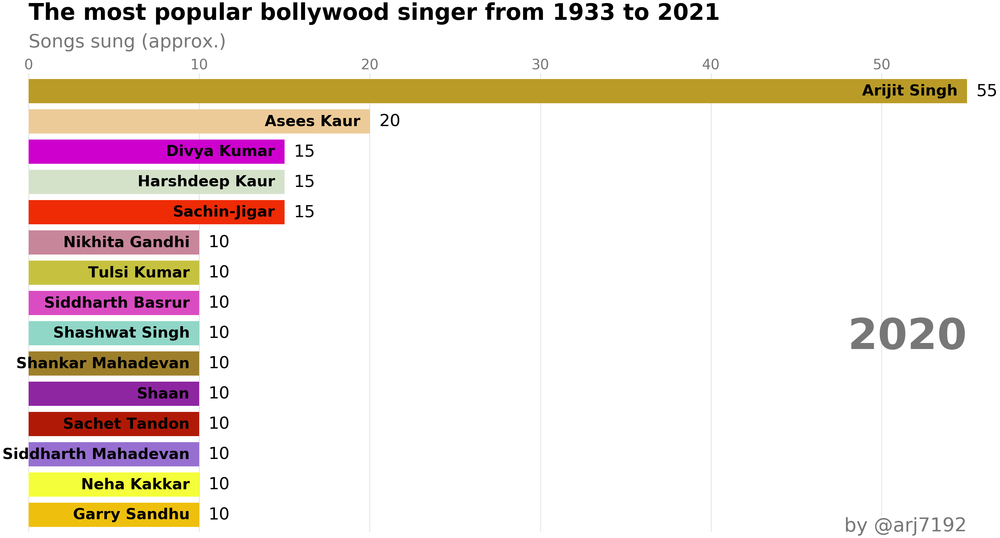

In [450]:
fig, ax = plt.subplots(figsize=(50, 25))
def draw_barchart(df, year, col_name):
    dff = df[df['year'].eq(year)].sort_values(by='count', ascending=True).tail(15)
    ax.clear()
    ax.barh(dff[col_name], dff['count'], color=[colors[x] for x in dff['Singer']])
#     ax.barh(dff[col_name], dff['count'])
#     dx = dff['count'].max() / 200
    dx = dff['count'].max()/100
    for i, (value, name) in enumerate(zip(dff['count'], dff[col_name])):
        ax.text(value-dx, i,     name, size=45, weight=570, ha='right', va='center')
#         ax.text(value-dx, i-.25, group_lk[name], size=10, color='#444444', ha='right', va='baseline')
        ax.text(value+dx, i,     f'{value:,.0f}',  size=50, ha='left',  va='center')
    # ... polished styles
    ax.text(1, 0.4, f"{year}", transform=ax.transAxes, color='#777777', 
            size=127, ha='right', weight=700)
    ax.text(0, 1.06, 'Songs sung (approx.)', transform=ax.transAxes, size=55, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=42)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.12, f'The most popular bollywood {col_name.lower()} from 1933 to 2021',
            transform=ax.transAxes, size=67, weight=600, ha='left')
    ax.text(1, 0, 'by @arj7192', transform=ax.transAxes, ha='right',
            color='#777777', bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'), size=57)
    plt.box(False)
    
draw_barchart(df_singers, 2020, 'Singer')

In [451]:
def draw_barchart_singer(yr):
    return draw_barchart(df_singers, yr, 'Singer')

Animation size has reached 20972943 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


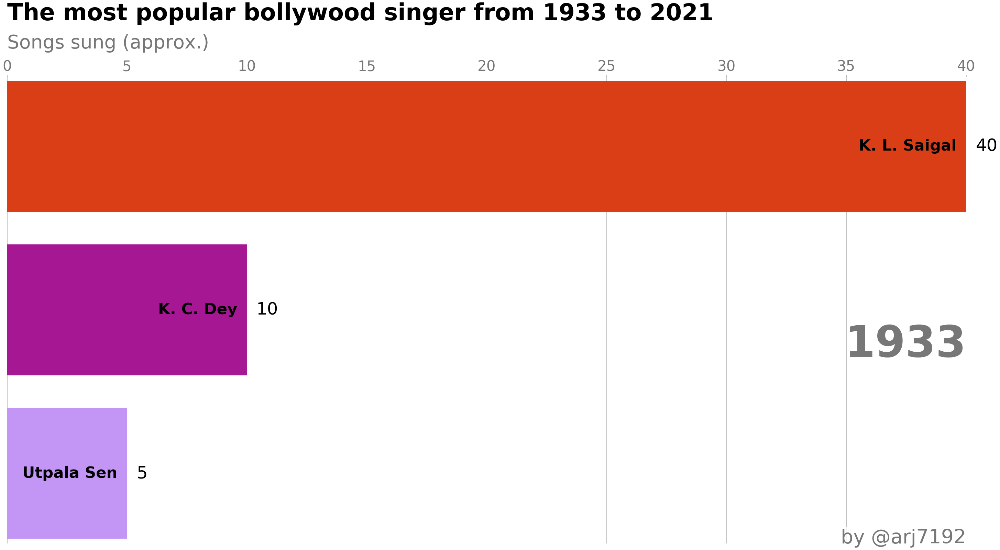

In [452]:
import matplotlib.animation as animation
from IPython.display import HTML
fig, ax = plt.subplots(figsize=(50, 25))
animator = animation.FuncAnimation(fig, draw_barchart_singer, frames=range(1933, 2021))
HTML(animator.to_jshtml()) 

In [453]:
from matplotlib.animation import FFMpegWriter

class SlowerFFMpegWriter(FFMpegWriter):
    '''FFMpeg-pipe writer bypassing figure.savefig.'''
    def __init__(self, **kwargs):
        '''Initialize the Writer object and sets the default frame_format.'''
        super().__init__(**kwargs)
        self.frame_format = 'argb'

    def grab_frame(self, **savefig_kwargs):
        '''Grab the image information from the figure and save as a movie frame.

        Doesn't use savefig to be faster: savefig_kwargs will be ignored.
        '''
        try:
            # re-adjust the figure size and dpi in case it has been changed by the
            # user.  We must ensure that every frame is the same size or
            # the movie will not save correctly.
            self.fig.set_size_inches(self._w, self._h)
            self.fig.set_dpi(self.dpi)
            # Draw and save the frame as an argb string to the pipe sink
            self.fig.canvas.draw()
            self._frame_sink().write(self.fig.canvas.tostring_argb()) 
        except (RuntimeError, IOError) as e:
            out, err = self._proc.communicate()
            raise IOError('Error saving animation to file (cause: {0}) '
                      'Stdout: {1} StdError: {2}. It may help to re-run '
                      'with --verbose-debug.'.format(e, out, err)) 

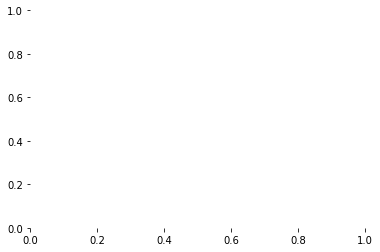

In [454]:
FFwriter = SlowerFFMpegWriter(fps=2)
animator.save('animation_singers.mp4', writer=FFwriter)